In [21]:
using ScikitLearn
using Statistics

using ScikitLearn.Pipelines: Pipeline, make_pipeline

@sk_import neighbors: KNeighborsClassifier
@sk_import neighbors: RadiusNeighborsClassifier
@sk_import neighbors: NearestNeighbors
@sk_import neighbors: NeighborhoodComponentsAnalysis

using Random
using DelimitedFiles

using ImageView, Images, ImageSegmentation

include("kNN/funcionesUtiles.jl");

In [26]:
function get_main_color(img, qValue1, qValue2, filter)
  
    matrizBooleana = filter.(img);
    matrizBooleana = closing(matrizBooleana)
    
    labelArray = ImageMorphology.label_components(matrizBooleana);
    
    boundingBoxes = ImageMorphology.component_boxes(labelArray);
    tamanos = ImageMorphology.component_lengths(labelArray); #Tamaño del grupo 
    pixeles = ImageMorphology.component_indices(labelArray);
    pixeles = ImageMorphology.component_subscripts(labelArray);
    centroides = ImageMorphology.component_centroids(labelArray);
    
    min_size = (size(img)[1]*size(img)[2]/600);
    
    etiquetasEliminar = findall(tamanos .<= min_size) .- 1; # Importate el -1, porque la primera etiqueta es la 0

    matrizBooleana = [!in(etiqueta,etiquetasEliminar) && (etiqueta!=0) for etiqueta in labelArray];
    
    labelArray = ImageMorphology.label_components(matrizBooleana);
    
    centroides = ImageMorphology.component_centroids(labelArray)[2:end];

    boundingBoxes = ImageMorphology.component_boxes(labelArray)[2:end];
    
    i = 1;
    R1 = Array{Float64,1}(undef, size(boundingBoxes));
    G1 = Array{Float64,1}(undef, size(boundingBoxes));
    B1 = Array{Float64,1}(undef, size(boundingBoxes));
    
    img_CHW = channelview(img);
    
    i = 1;
    for boundingBox in boundingBoxes
        x1 = boundingBox[1][1];
        y1 = boundingBox[1][2];
        x2 = boundingBox[2][1];
        y2 = boundingBox[2][2];

        R1[i] = quantile(skipmissing(img_CHW[1,x1:x2,y1:y2]), qValue1);
        G1[i] = quantile(skipmissing(img_CHW[2,x1:x2,y1:y2]), qValue1);
        B1[i] = quantile(skipmissing(img_CHW[3,x1:x2,y1:y2]), qValue1);
        i= i + 1;
    end;
    
    if(maximum(labelArray) == 0)
        return (quantile(skipmissing(red.(img)), qValue2), quantile(skipmissing(green.(img)), qValue2), quantile(skipmissing(blue.(img)),qValue2))
    else 
        return (quantile(skipmissing(R1), qValue2), quantile(skipmissing(G1), qValue2), quantile(skipmissing(B1),qValue2))
    end
end

get_main_color (generic function with 1 method)

In [22]:
esPixelRojo(pixel::RGBA, dRV=0.3, dRA=0.3) = (pixel.r > pixel.g + dRV) && (pixel.r > pixel.b + dRA);

In [23]:
esPixelRojo(pixel::RGB, dRV=0.3, dRA=0.3) = (pixel.r > pixel.g + dRV) && (pixel.r > pixel.b + dRA);

In [24]:
esPixelBlanco(pixel::RGB, dr=0.3, dg=0.3, db=0.3) = (pixel.r + dr >= 1) && (pixel.g + dg >= 1) && (pixel.b + db >= 1);

In [25]:
esPixelBlanco(pixel::RGBA, dr=0.3, dg=0.3, db=0.3) = (pixel.r + dr >= 1) && (pixel.g + dg >= 1) && (pixel.b + db >= 1);

In [27]:
function process_image(image)
    img = copy(image);
    img_CHW = channelview(img);
    
    (R1, G1, B1) = get_main_color(img, 0.99, 0.99, esPixelRojo)
    (R2, G2, B2) = get_main_color(img, 0.75, 0.95, esPixelBlanco)

    patron = [
        mean(img_CHW[1,:,:]), 
        mean(img_CHW[2,:,:]), 
        mean(img_CHW[3,:,:]),
        std(img_CHW[1,:,:]), 
        std(img_CHW[2,:,:]), 
        std(img_CHW[3,:,:]),
        R1,
        G1,
        B1,
        R2,
        G2,
        B2];
        
    return patron;
end;

In [28]:
function prepare_data(dir, n_inputs, output, patronesEnFilas = true)
    directorio = readdir(dir);
    
    salidas_deseadas = zeros(1, size(directorio,1));
    patrones = Array{Float64,2}(undef, size(directorio,1),n_inputs);
    
    i = 1
    
    if(patronesEnFilas)
        for file in directorio 
            image = load(string(dir,"/",file));
            patrones[i,:] = process_image(image)[:];
            salidas_deseadas[i] = output;
            i = i + 1
            
        end;
    else
        for file in directorio 
            image = load(string(dir,"/",file));
            patrones[:,i] = process_image(image)[:];
            salidas_deseadas[i] = output;
            i = i + 1
        end;
    end

    return patrones, salidas_deseadas;
end;

In [9]:
function get_orange_white_boolean(imagen)
    
    diferenciaRojoVerde = 0.3; 
    diferenciaRojoAzul = 0.3;
    
    canalRojo = red.(imagen); 
    canalVerde = green.(imagen); 
    canalAzul = blue.(imagen);
    
    white_chanel = (zeros(size(canalRojo)[1], size(canalRojo)[2]).+0.6);
    white_chanel1 = (zeros(size(canalRojo)[1], size(canalRojo)[2]).+0.9);
    
    mb_w =  (canalRojo.>white_chanel.+ mean(canalRojo)) .& 
            (canalVerde.>white_chanel.- mean(canalVerde)) .& 
            (canalAzul.>white_chanel.- mean(canalAzul));
    
    mb_w1 =  (canalRojo.>white_chanel1) .& 
            (canalVerde.>white_chanel1) .& 
            (canalAzul.>white_chanel1);
    
    mb_r =  (canalRojo.>(canalVerde.+diferenciaRojoVerde)) .& 
            (canalRojo.>(canalAzul.+diferenciaRojoAzul));
    
    matrizBooleana = mb_r .| mb_w1 #.| mb_w1; 
    
    return matrizBooleana;
end;

In [10]:
function check_region(x1, y1, x2, y2, imagen, modelo, nImputs, wall)
    img_v = @view imagen[x1:x2, y1:y2]
    img_CHW = channelview(img_v)

    xtrain = convert(Array{Float64}, process_image(img_v));
    
    xtrain_aux =  reshape(xtrain,1,nImputs);
    if(modelo.predict(xtrain_aux)[1] == 1.0)
        imagen[x1:x2, y1] .= RGB(0,1,0);
        imagen[x1:x2, y2] .= RGB(0,1,0);
        imagen[x1, y1:y2] .= RGB(0,1,0);
        imagen[x2, y1:y2] .= RGB(0,1,0);
    else
        imagen[x1:x2, y1] .= RGB(1,0,0);
        imagen[x1:x2, y2] .= RGB(1,0,0);
        imagen[x1, y1:y2] .= RGB(1,0,0);
        imagen[x2, y1:y2] .= RGB(1,0,0);
    end
end

check_region (generic function with 1 method)

In [11]:
function process_picture(filePath, modelo, nImputs, wall)
    imagen = load(filePath);
    booleanMatrix = get_orange_white_boolean(imagen)
    booleanMatrix = closing(dilate(booleanMatrix,[1,2]))

    if(!maximum(booleanMatrix))
        booleanMatrix = get_orange_white_boolean(imagen);
    end;
    
    labelArray = ImageMorphology.label_components(booleanMatrix);
    boundingBoxes = ImageMorphology.component_boxes(labelArray);
    tamanos = ImageMorphology.component_lengths(labelArray); #Tamaño del grupo 
    pixeles = ImageMorphology.component_indices(labelArray);
    pixeles = ImageMorphology.component_subscripts(labelArray);
    centroides = ImageMorphology.component_centroids(labelArray);

    min_size = (size(imagen)[1]*size(imagen)[2]/600);
    etiquetasEliminar = findall(tamanos .<= min_size) .- 1;
    matrizBooleana = [!in(etiqueta,etiquetasEliminar) && (etiqueta!=0) for etiqueta in labelArray];
    
    labelArray = ImageMorphology.label_components(matrizBooleana);
    imagenObjetos = RGB.(matrizBooleana, matrizBooleana, matrizBooleana);
    centroides = ImageMorphology.component_centroids(labelArray)[2:end];
    
    for centroide in centroides
        x = Int(round(centroide[1]));
        y = Int(round(centroide[2]));
        imagenObjetos[ x, y ] = RGB(1,0,0);
    end;
    
    imagen = load(filePath)
    
    boundingBoxes = ImageMorphology.component_boxes(labelArray)[2:end];
    
    for boundingBox in boundingBoxes
        x1 = boundingBox[1][1];
        y1 = boundingBox[1][2];
        x2 = boundingBox[2][1];
        y2 = boundingBox[2][2];

        check_region(x1,y1,x2,y2, imagen, modelo, nImputs, wall)
    end;
    return imagen;
end;

In [12]:
function alg_factory(tipoAlg, nProximos)
    if(tipoAlg == "pipelineKnn")
        nca = NeighborhoodComponentsAnalysis(random_state=42)
        knn = KNeighborsClassifier(n_neighbors=nProximos)
        return Pipeline([("nca", nca), ("knn", knn)])
    elseif(tipoAlg == "radius")
        return  (RadiusNeighborsClassifier(nProximos), predecir(X,Y) = predict(X,Y))
    elseif (tipoAlg == "knn")
        return KNeighborsClassifier(nProximos)
    elseif (tipoAlg == "nearest")
        return (NearestNeighbors(nProximos, algorithm="ball_tree"), predecir(X,Y) = X.fit(Y) )
    end
end


alg_factory (generic function with 1 method)

In [13]:
function knn_training(patrones, salidasDeseadas, porcentajeTest, numEjecuciones, nProximos, tipoAlg)    
    salidasDeseadas = indexin( salidasDeseadas, unique(salidasDeseadas) );
    numPatrones = size(patrones, 1);
    
    valoresNormalizacion = normalizarMaxMin!(patrones; patronesEnFilas=true);
    
    precisionesEntrenamiento = Array{Float64,1}();
    precisionesTest = Array{Float64,1}();
    
    bestPrecisionTest = 0;
    bestModelo = alg_factory(tipoAlg,nProximos);
    
    for numEjecucion in 1:numEjecuciones

        println("Ejecucion ", numEjecucion);

        (indicesPatronesEntrenamiento, indicesPatronesTest) = holdOut(numPatrones, porcentajeTest);

        modelo = alg_factory(tipoAlg,nProximos);

        fit!(modelo, patrones[indicesPatronesEntrenamiento,:], salidasDeseadas[indicesPatronesEntrenamiento]);

        clasificacionEntrenamiento = predict(modelo, patrones[indicesPatronesEntrenamiento,:]);
        precisionEntrenamiento = 100*mean(clasificacionEntrenamiento .== salidasDeseadas[indicesPatronesEntrenamiento]);
        println("Precision en el conjunto de entrenamiento: $precisionEntrenamiento %");

        clasificacionTest = predict(modelo, patrones[indicesPatronesTest,:]);
        precisionTest = 100*mean(clasificacionTest .== salidasDeseadas[indicesPatronesTest]);
        println("Precision en el conjunto de test: $precisionTest %");
        
        push!(precisionesEntrenamiento, precisionEntrenamiento);
        push!(precisionesTest, precisionTest);
        
        if(precisionTest > bestPrecisionTest)
            bestPrecisionTest = precisionTest;
            bestModelo = modelo;
        end;

    end;
    
    println("Resultados en promedio al separar las 3 clases:")
    println("   Entrenamiento: ", mean(precisionesEntrenamiento), " %, desviacion tipica: ", std(precisionesEntrenamiento));
    println("   Test:          ", mean(precisionesTest), " %, desviacion tipica: ", std(precisionesTest));
    
    return (bestPrecisionTest, bestModelo);
    
end;

In [14]:
function shuffle_patterns(patterns, outputs)
    c = hcat(outputs,patterns)
    c = c[shuffle(1:end),:]
    c = c[shuffle(1:end),:]
    return c[:, 2:(size(c)[2])], c[:, 1:1][:,1]
end

shuffle_patterns (generic function with 1 method)

In [15]:
function find_bestK(patrones, salidasDeseadas, porcentajeTest, numEjecuciones, maxValley, tipoKNN)
    kN = 3;
    stop = false;
    counter = 0;
    
    (bpTest, bModelo) = knn_training(patrones, salidasDeseadas, porcentajeTest, numEjecuciones, kN, tipoKNN)
    while (!stop )
        kN = kN + 2
        
        (pTest, modelo) = knn_training(patrones, salidasDeseadas, porcentajeTest, numEjecuciones, kN, tipoKNN)
        
        if (pTest > bpTest)
            bpTest = pTest
            bModelo = modelo
            counter = 0
        else
            counter = counter +1;
        end
        
        if (counter > maxValley)
            stop = true
        end;
    end;
    
    println("Resultados Mejor modelo: ");
    println("   kN's: ", kN);
    println("   Test: ", bpTest,"%");
    
    return bModelo
end;

In [31]:
porcentajeTest = 0.4;
numEjecuciones = 50;

#Numero de patrones más próximos que se buscarán, si clases par nProximos impar
nProximos = 3;

patrones_si, salidas_deseadas_si = prepare_data("../db/positivos", 12, 1);
patrones_no, salidas_deseadas_no = prepare_data("../db/negativos", 12, 0);

salidasDeseadas =  convert(Array{Float64}, hcat(salidas_deseadas_si, salidas_deseadas_no));
salidasDeseadas = reshape(convert(Array{Float64},hcat(salidas_deseadas_si, salidas_deseadas_no)),size(salidasDeseadas,2),1)

patrones =  convert(Array{Float64}, vcat(patrones_si, patrones_no));

#patrones, salidasDeseadas = shuffle_patterns(patrones, salidasDeseadas);


In [39]:
#fMejorModelo = find_bestK(patrones, salidasDeseadas, porcentajeTest, numEjecuciones, 1,"knn");
(_,fMejorModelo) = knn_training(patrones, salidasDeseadas, porcentajeTest, numEjecuciones, 5, "knn");

Ejecucion 1
Precision en el conjunto de entrenamiento: 89.90825688073394 %
Precision en el conjunto de test: 90.27777777777779 %
Ejecucion 2
Precision en el conjunto de entrenamiento: 90.82568807339449 %
Precision en el conjunto de test: 83.33333333333334 %
Ejecucion 3
Precision en el conjunto de entrenamiento: 92.66055045871559 %
Precision en el conjunto de test: 77.77777777777779 %
Ejecucion 4
Precision en el conjunto de entrenamiento: 89.90825688073394 %
Precision en el conjunto de test: 80.55555555555556 %
Ejecucion 5
Precision en el conjunto de entrenamiento: 91.74311926605505 %
Precision en el conjunto de test: 88.88888888888889 %
Ejecucion 6
Precision en el conjunto de entrenamiento: 91.74311926605505 %
Precision en el conjunto de test: 81.94444444444444 %
Ejecucion 7
Precision en el conjunto de entrenamiento: 94.4954128440367 %
Precision en el conjunto de test: 80.55555555555556 %
Ejecucion 8
Precision en el conjunto de entrenamiento: 87.1559633027523 %
Precision en el conjunto

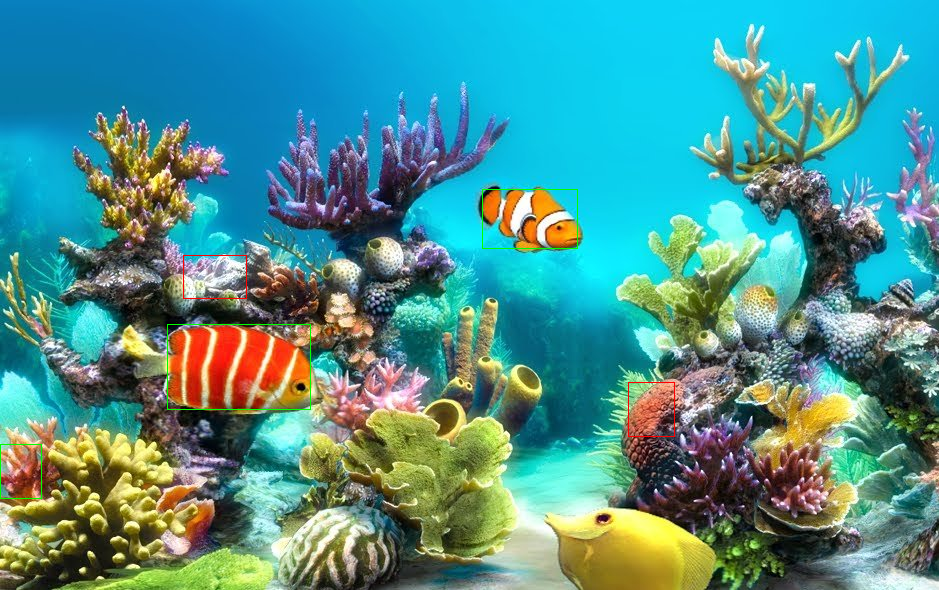

pez001.jpg


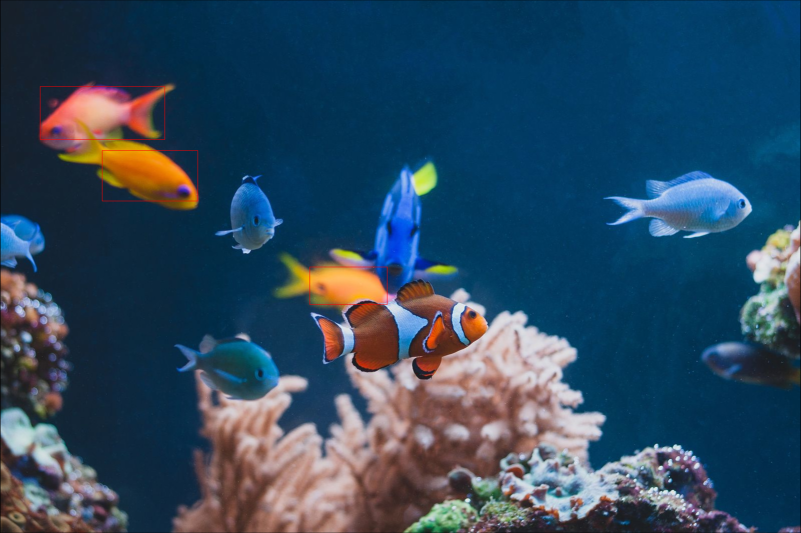

pez002.jpg


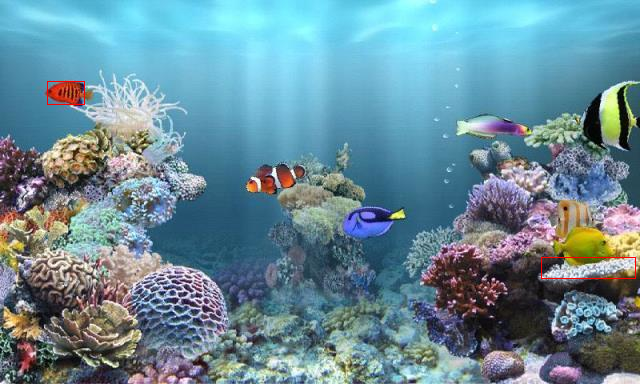

pez003.jpg


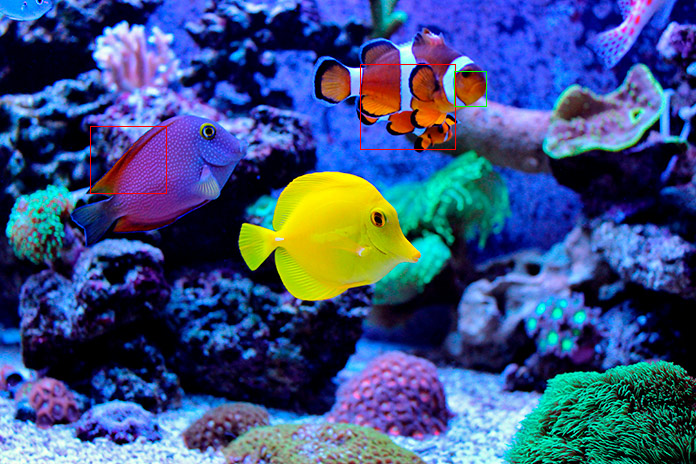

pez004.jpg


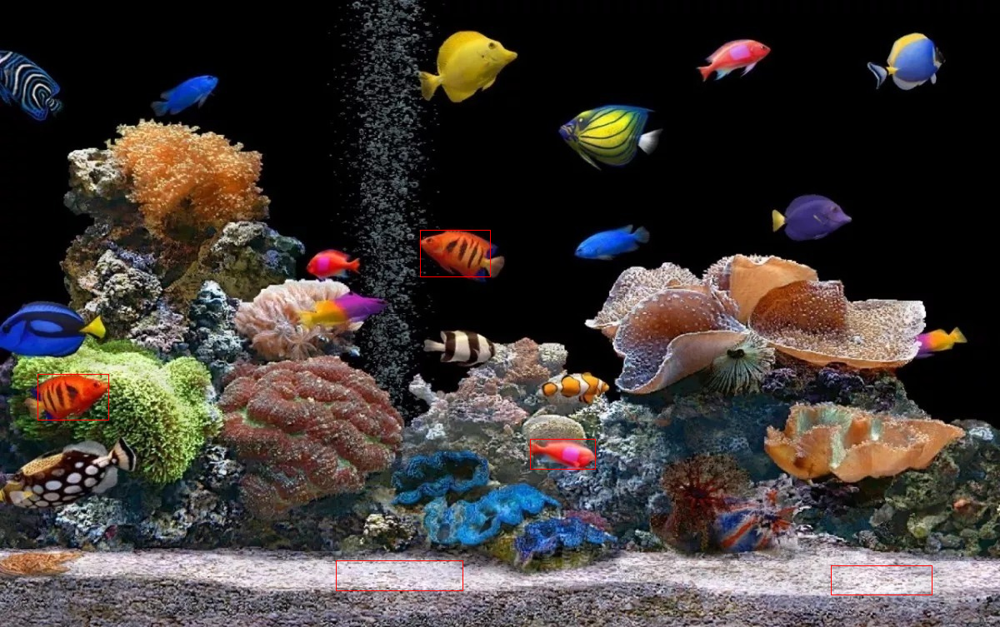

pez005.jpg


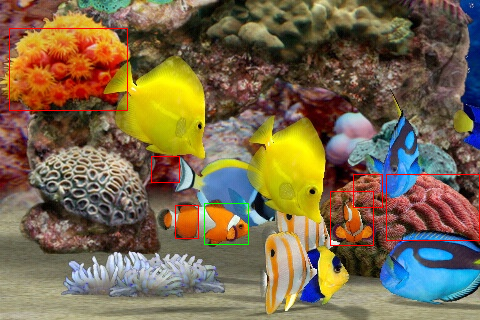

pez006.jpg


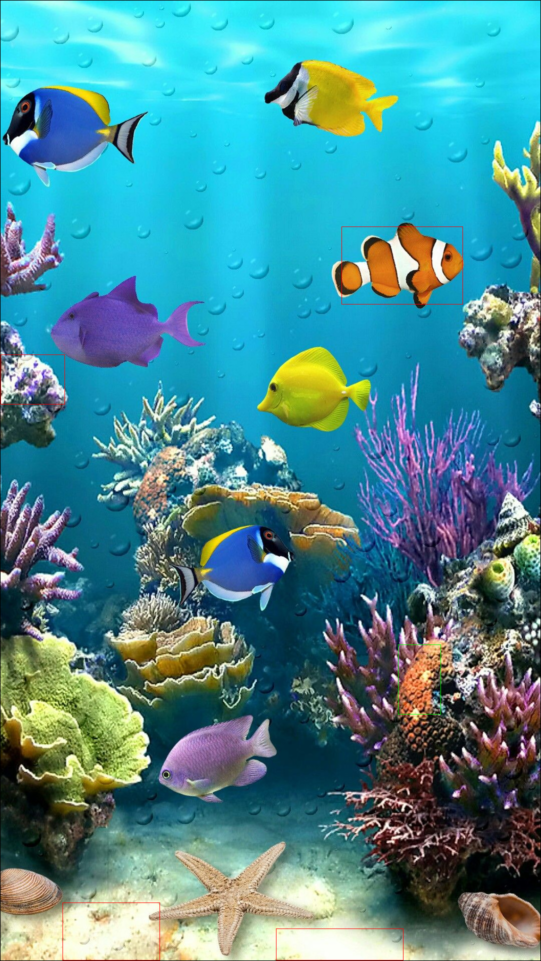

pez007.jpg


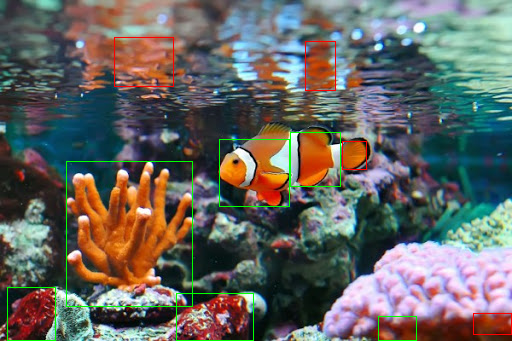

pez008.jpg


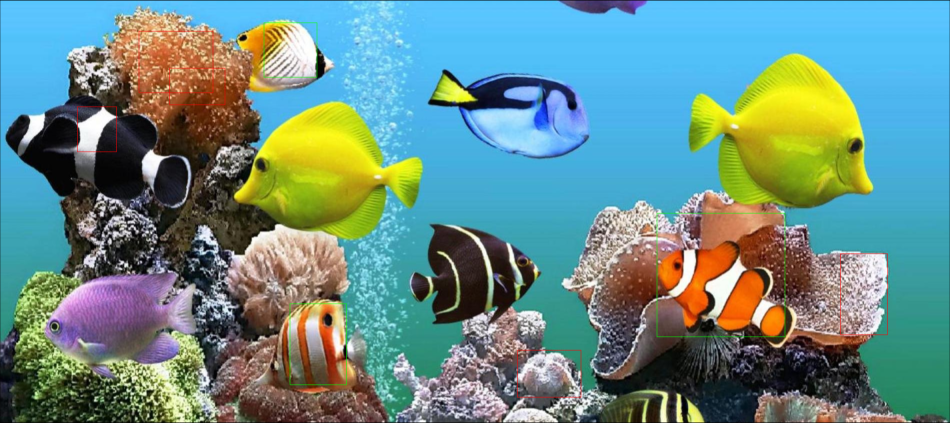

pez009.jpg


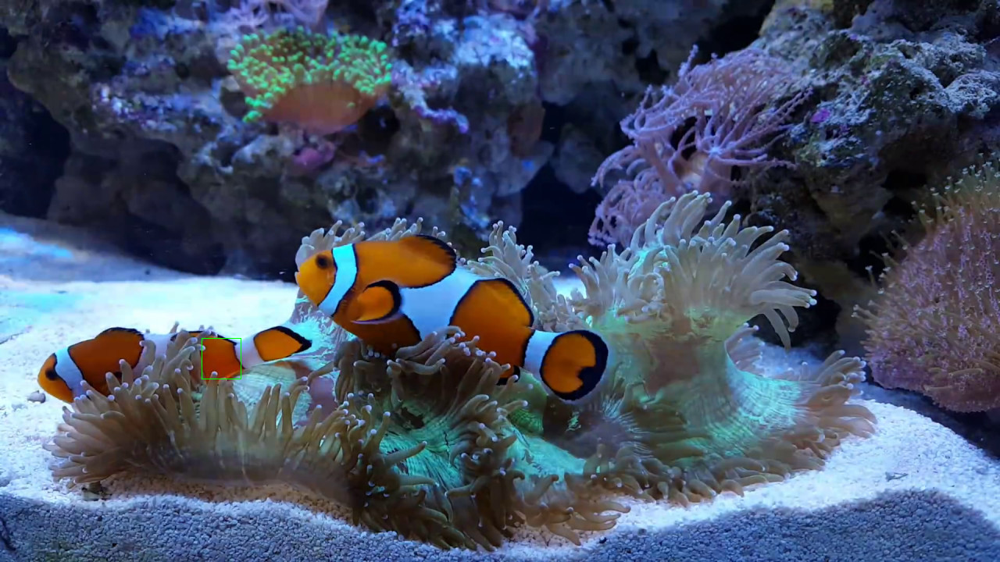

pez010.jpg


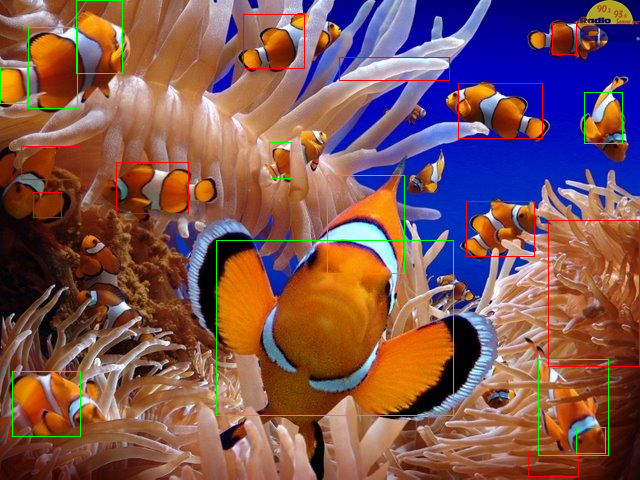

pez011.jpg


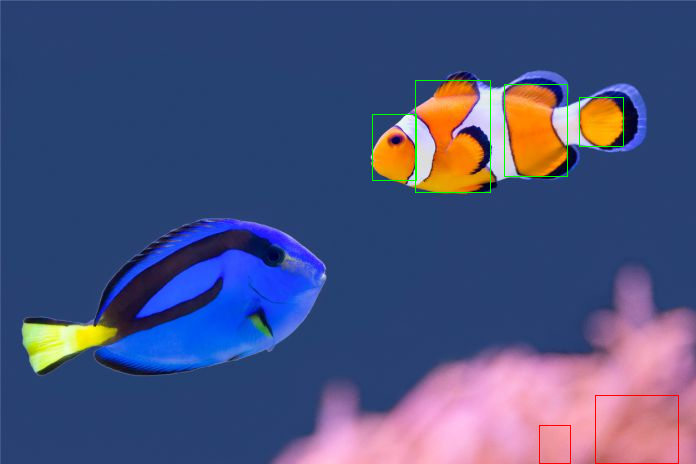

pez012.jpg


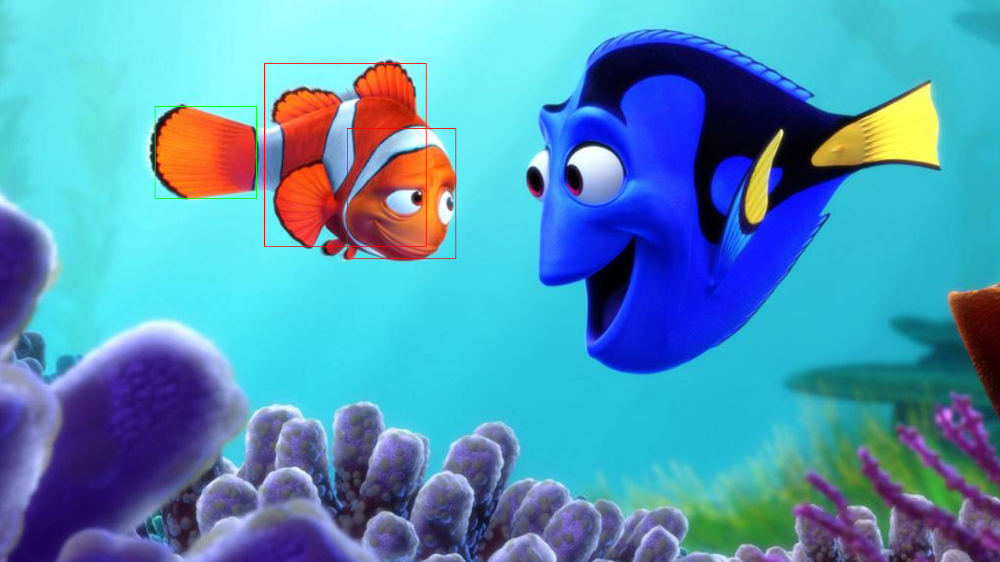

pez013.jpg


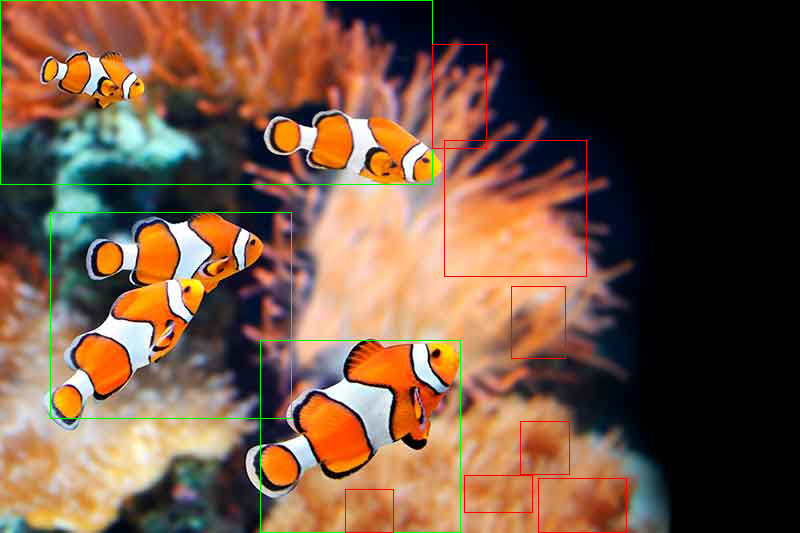

pez014.jpg


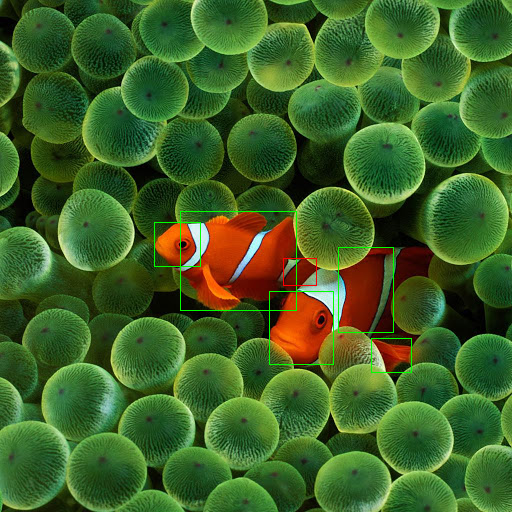

pez015.jpg


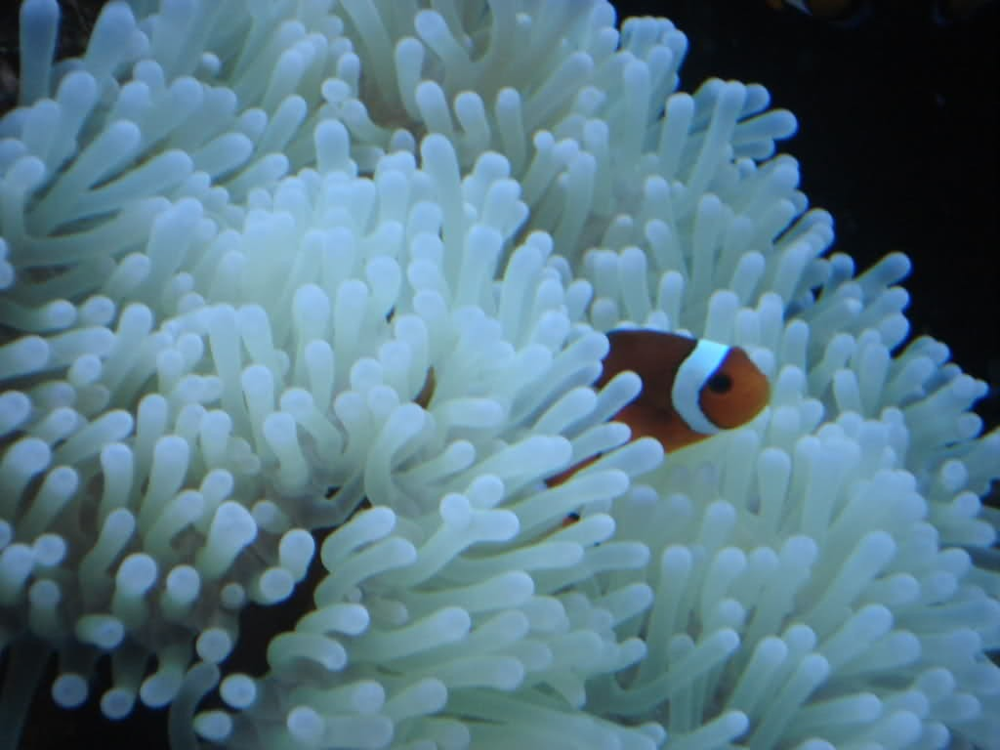

pez016.jpg


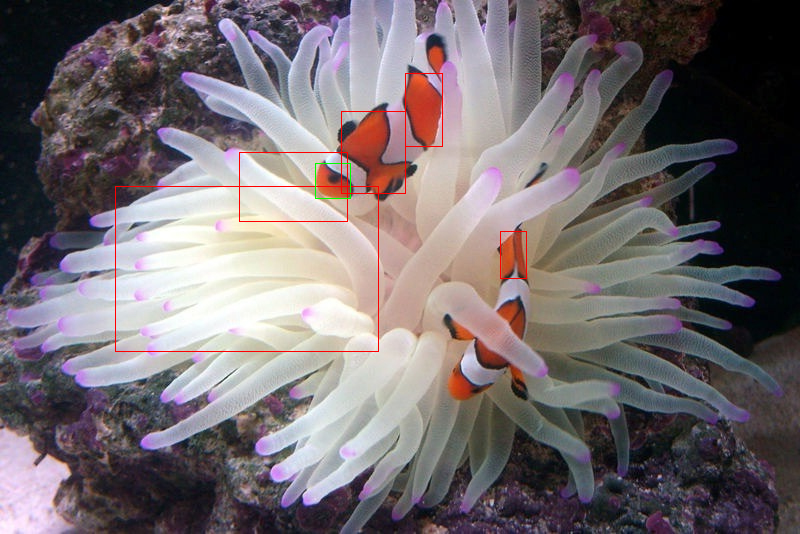

pez017.jpg


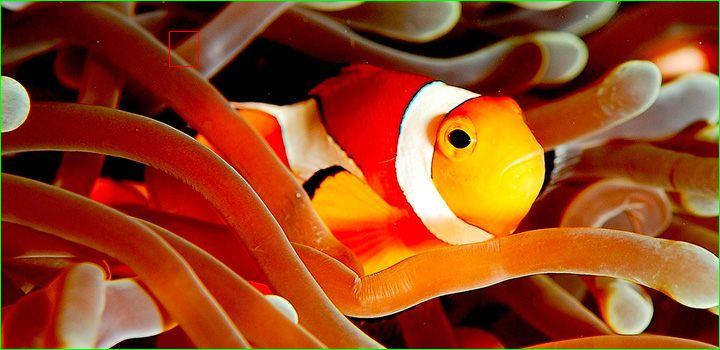

pez018.jpg


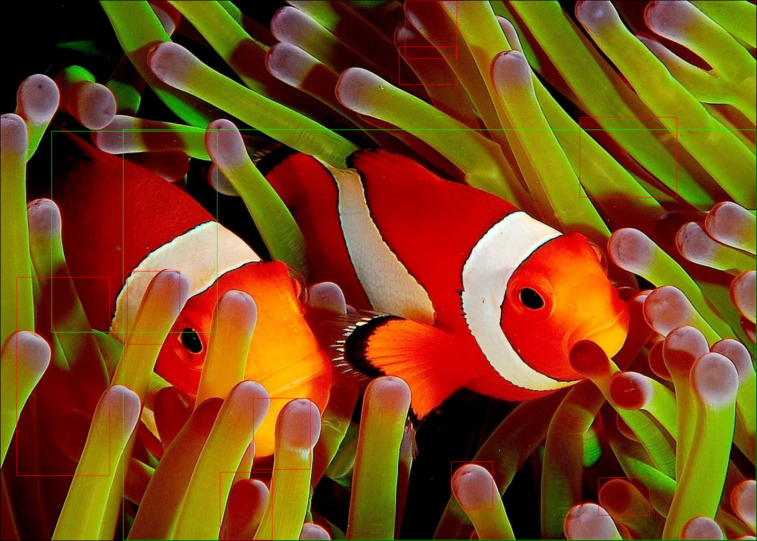

pez019.jpg


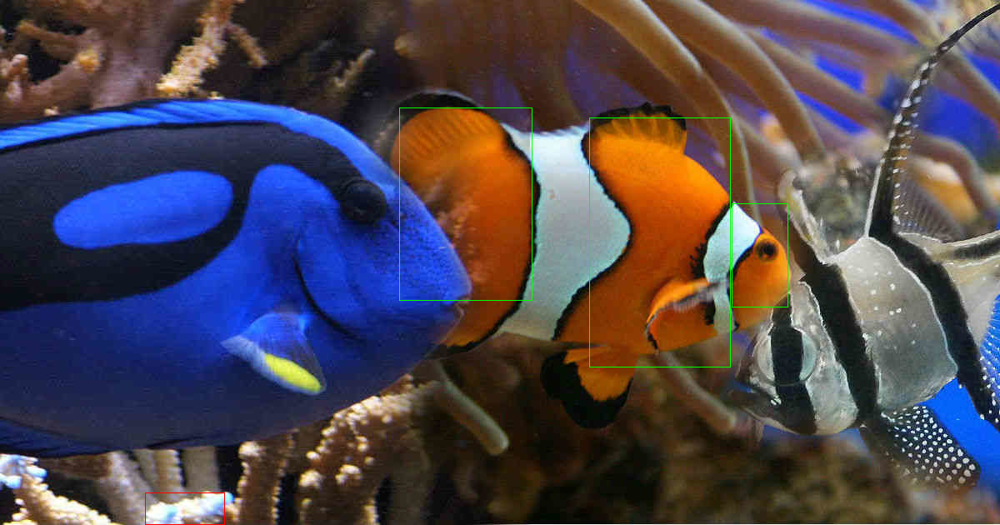

pez020.jpg


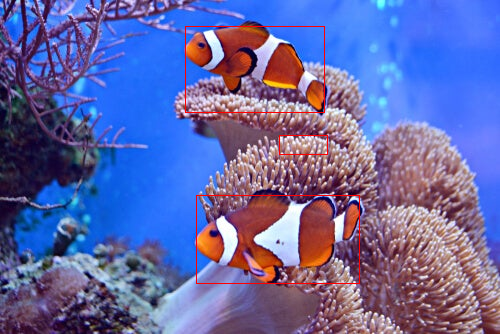

pez021.jpg


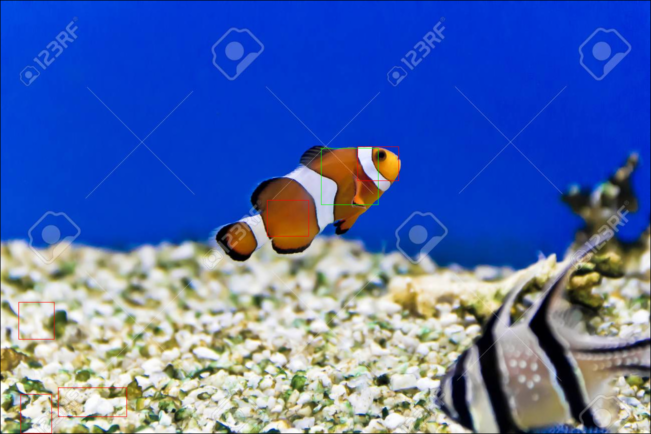

pez022.jpg


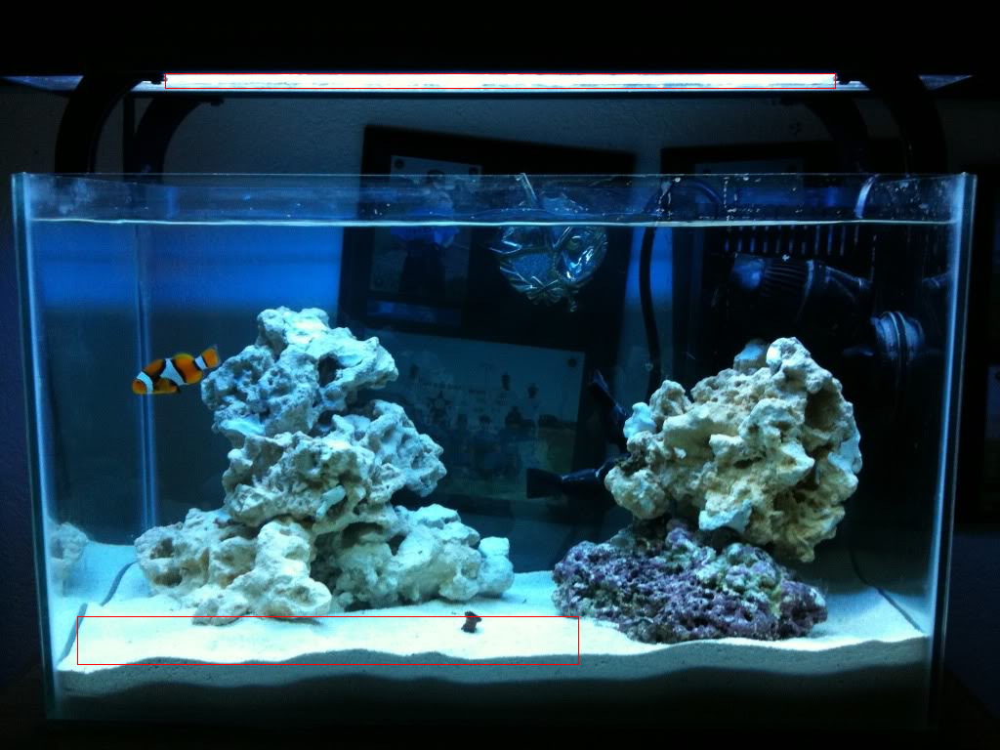

pez023.jpg


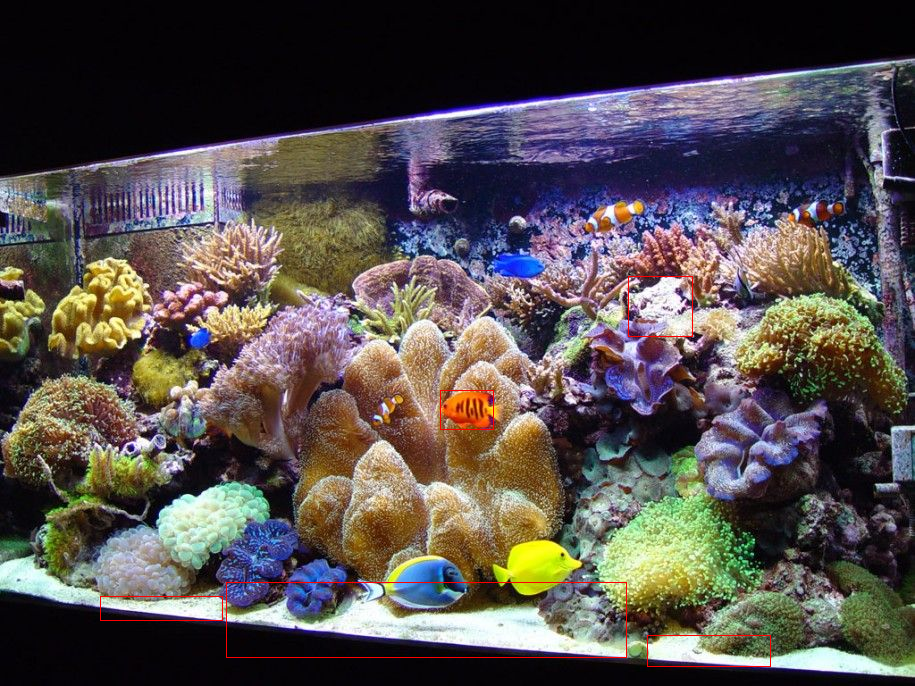

pez024.jpg


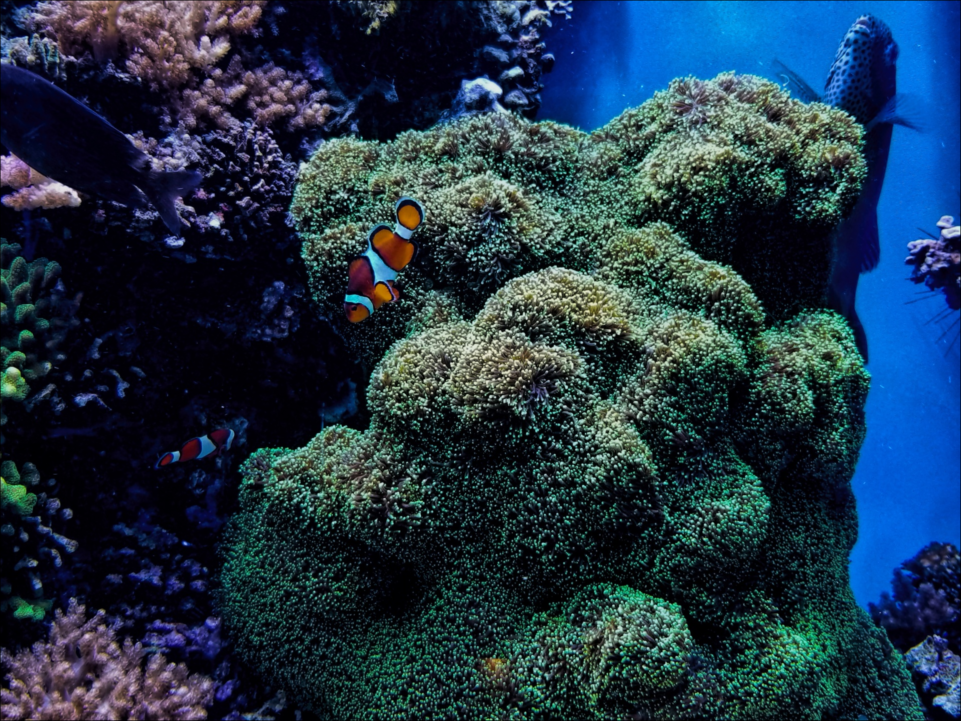

pez025.jpg


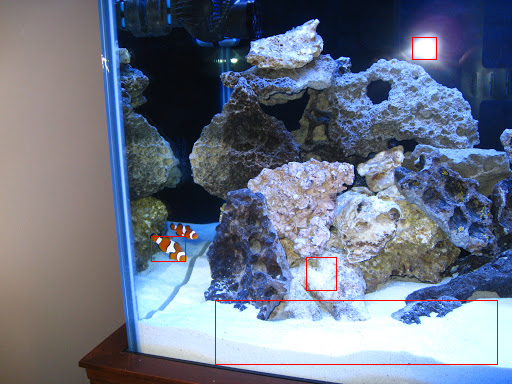

pez026.jpg


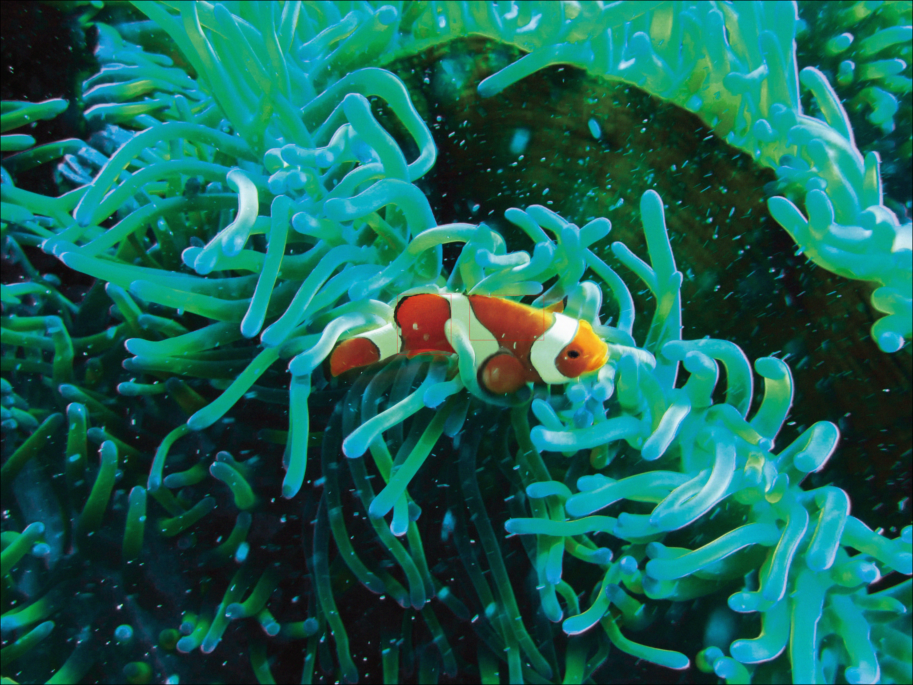

pez027.jpg


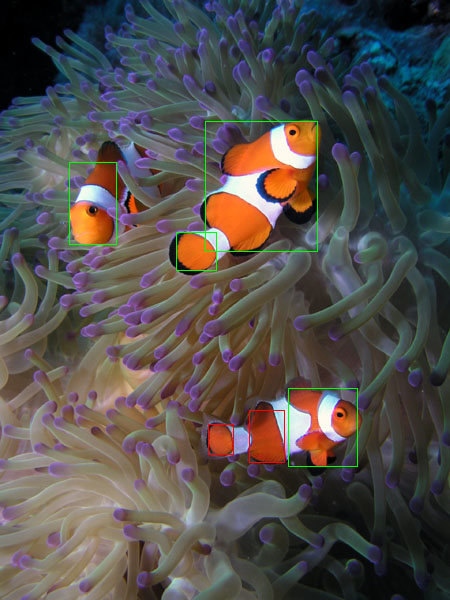

pez028.jpg


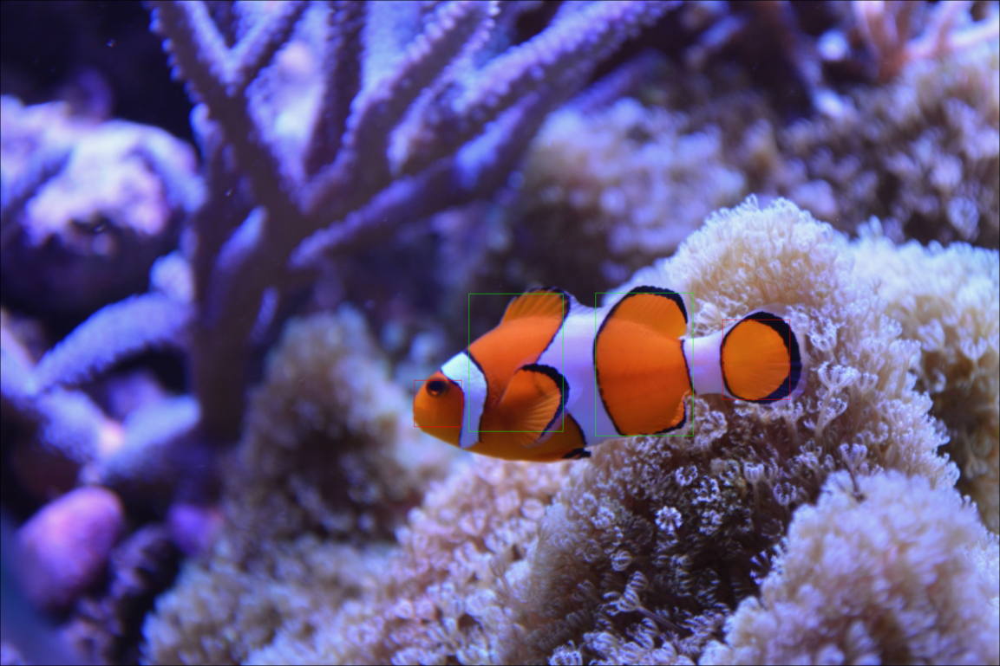

pez029.jpg


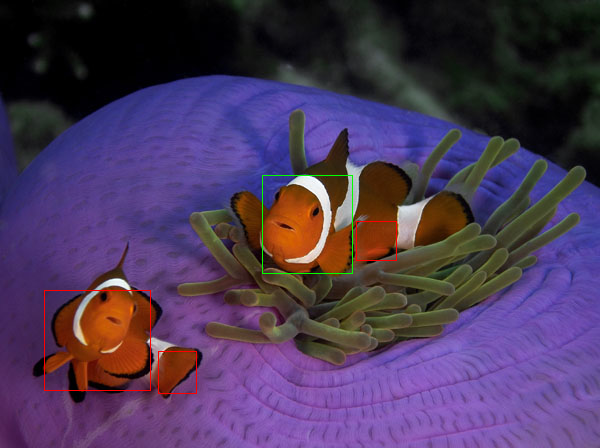

pez030.jpg


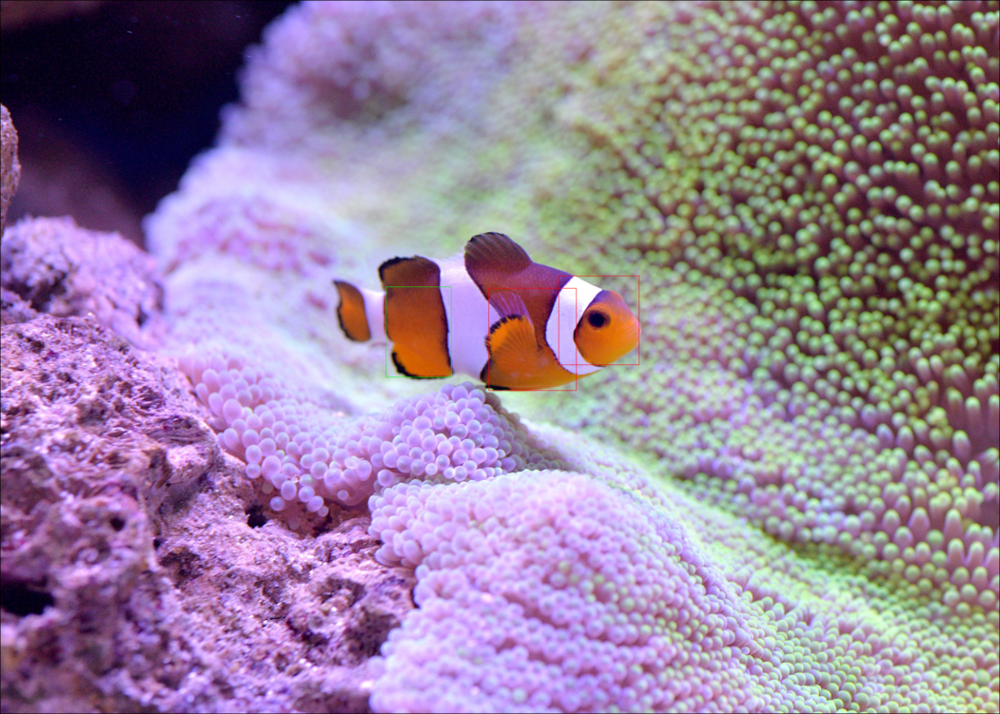

pez031.jpg


In [40]:
directorio = readdir("../db/fotos");

for file in directorio 
    println(file);
    imagen = process_picture(string("../db/fotos/",file), fMejorModelo, 12, 0.72);
    display(imagen)
end; 
